In [ ]:
!pip show geopandas

Name: geopandas
Version: 1.0.1
Summary: Geographic pandas extensions
Home-page: 
Author: 
Author-email: Kelsey Jordahl <kjordahl@alum.mit.edu>
License: BSD 3-Clause
Location: /usr/local/lib/python3.10/dist-packages
Requires: numpy, packaging, pandas, pyogrio, pyproj, shapely
Required-by: bigframes


In [ ]:
pip install fiona

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.6/56.6 kB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 68.6 MB/s eta 0:00:00


In [ ]:
linkWorldMap="https://github.com/Halabbi/introgeodf2/raw/refs/heads/main/worldMaps%20.gpkg"

import geopandas as gpd
from  fiona import listlayers
listlayers(linkWorldMap)


['countries', 'rivers', 'cities']

In [ ]:
airports_Russia="https://github.com/Halabbi/introgeodf2/raw/refs/heads/main/airports%20(1).gpkg"

import geopandas as gpd
from  fiona import listlayers
listlayers(airports_Russia)

['rivers', 'airports_6078']

In [ ]:
countries=gpd.read_file(linkWorldMap,layer='countries')
rivers=gpd.read_file(linkWorldMap,layer='rivers')
cities=gpd.read_file(linkWorldMap,layer='cities')
airports_Rusia=gpd.read_file(airports_Russia,layer='airports_6078')

In [ ]:
#Seleccionamos el país y encontramos su centroide
rusia=countries[countries.COUNTRY=='Russia']

In [ ]:
#Seleccionamos el país
rusia=countries[countries.COUNTRY=='Russia']

In [ ]:
rusia_6078=rusia.to_crs(6078)

In [ ]:
rusia_6078.head()

,COUNTRY,geometry
188,Russia,"MULTIPOLYGON (((15109031.538 3917547.292, 1510..."


In [ ]:
#Centroide de Rusia
centroid=rusia_6078.centroid


In [ ]:
citiesRusia_clipped= gpd.clip(gdf=cities.to_crs(6078),
                          mask=rusia_6078)
riversRusia_clipped = gpd.clip(gdf=rivers.to_crs(6078),
                               mask=rusia_6078)

In [ ]:
#Los límites de Rusia
rusia_6078.total_bounds

array([11807370.64217146,    95446.02561431, 20250312.29794789,
        5485536.46651407])

In [ ]:
#Los límites de los ríos de Rusia
riversRusia_clipped.total_bounds


array([12158367.80467051,   163504.84222059, 19217871.01839928,
        4228894.90930308])

<Axes: >

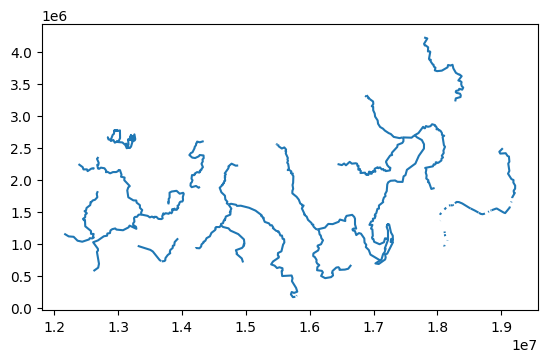

In [ ]:
riversRusia_clipped.cx[:, :].plot()

In [ ]:
#Los límites de los aeropuertos de Rusia
airports_Rusia.total_bounds

array([11839498.85218068,   124114.13314903, 20258831.95747615,
        5523188.92631749])

In [ ]:
#Los límites del centroide de Rusia
centroid.total_bounds

array([16052701.15946091,  2148267.30328144, 16052701.15946091,
        2148267.30328144])

In [ ]:
#Los límites del las ciudades de Rusia
citiesRusia_clipped.total_bounds

array([12179490.07564848,   615451.79925766, 19725723.21361826,
        4893441.78948158])

<Axes: >

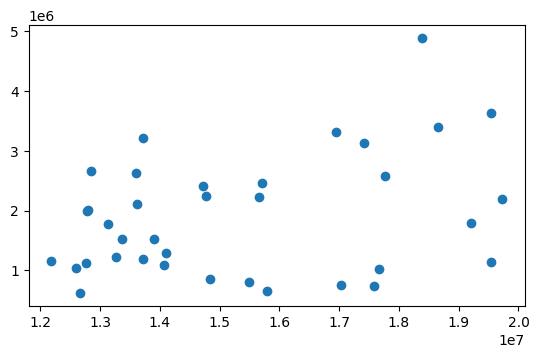

In [ ]:
citiesRusia_clipped.cx[:, :].plot()

In [ ]:
# Se obtiene los límites máximos y mínimos de las ciudades
minx, miny, maxx, maxy = citiesRusia_clipped.total_bounds

In [ ]:
# Se obtiene los límites máximos y mínimos de los aeropuertos
minx, miny, maxx, maxy = airports_Rusia.total_bounds

In [ ]:
#Se obtiene los límites máximos y mínimos de los ríos
minx, miny, maxx, maxy = riversRusia_clipped.total_bounds

<Axes: >

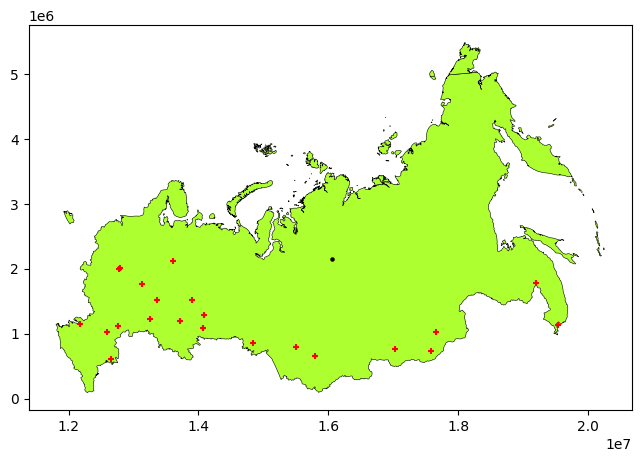

In [ ]:
# Base del mapa
base = rusia_6078.plot(facecolor="greenyellow", edgecolor='black', linewidth=0.4, figsize=(9,5))

# Centróide
rusia_6078.centroid.plot(color='black', markersize=5, ax=base)

# Ciudades de Rusia por debajo del centroide (coordenadas Y menores que 2148267.30328144)
citiesRusia_clipped.cx[minx:19725723.21361826, miny:2148267.30328144].plot(
    marker='+', color='red', markersize=15, ax=base)

<Axes: >

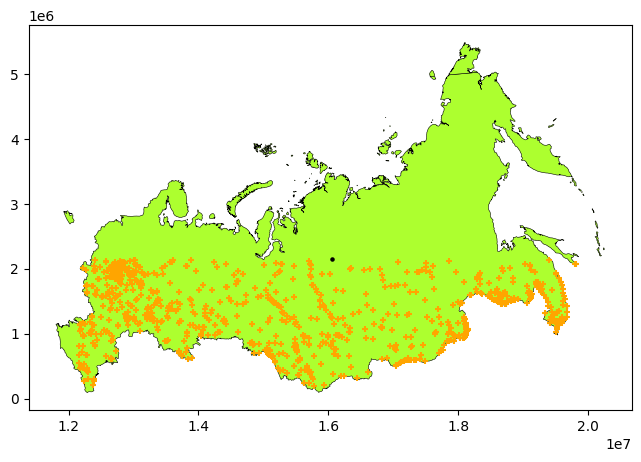

In [ ]:
# Base del mapa
base = rusia_6078.plot(facecolor="greenyellow", edgecolor='black', linewidth=0.4, figsize=(9,5))

# Centróide
rusia_6078.centroid.plot(color='black', markersize=5, ax=base)

#Aeropuertos de Rusia por debajo del centroide (coordenadas y menores que 2148267.30328144)
airports_Rusia.cx[minx:20258831.95747615, miny:2148267.30328144].plot(
    marker='+', color='orange', markersize=15, ax=base)

<Axes: >

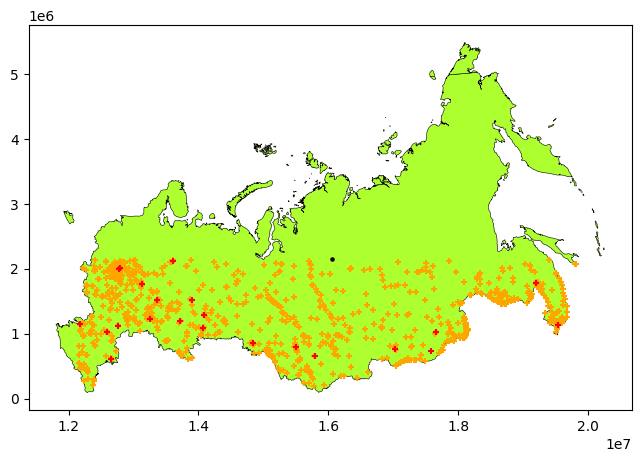

In [ ]:
# Ciudades y aeropuertos debajo del centroide
base = rusia_6078.plot(facecolor="greenyellow", edgecolor='black', linewidth=0.4, figsize=(9,5))
rusia_6078.centroid.plot(color='black', markersize=5, ax=base)
airports_Rusia.cx[minx:20258831.95747615, miny:2148267.30328144].plot(
    marker='+', color='orange', markersize=15, ax=base)
citiesRusia_clipped.cx[minx:19725723.21361826, miny:2148267.30328144].plot(
    marker='+', color='red', markersize=15, ax=base)

<Axes: >

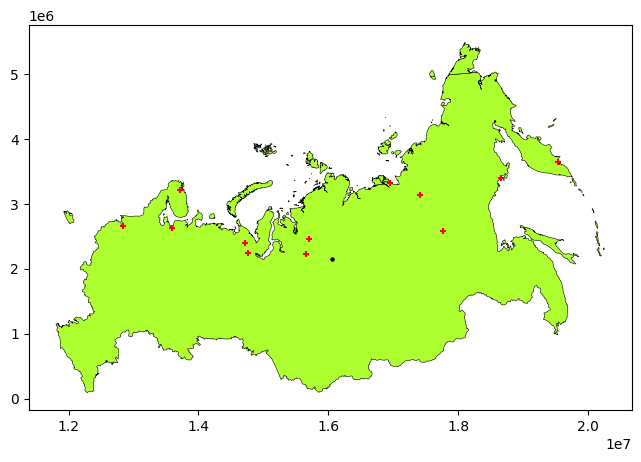

In [ ]:
# Base del mapa
base = rusia_6078.plot(facecolor="greenyellow", edgecolor='black', linewidth=0.4, figsize=(9,5))

# Centróide
rusia_6078.centroid.plot(color='black', markersize=5, ax=base)

# Ciudades por encima del centroide (coordenadas Y mayores que 2148267.30328144)

citiesRusia_clipped.cx[minx:19725723.21361826 , maxy: 2148267.30328144].plot(
    marker='+', color='red', markersize=15, ax=base)


<Axes: >

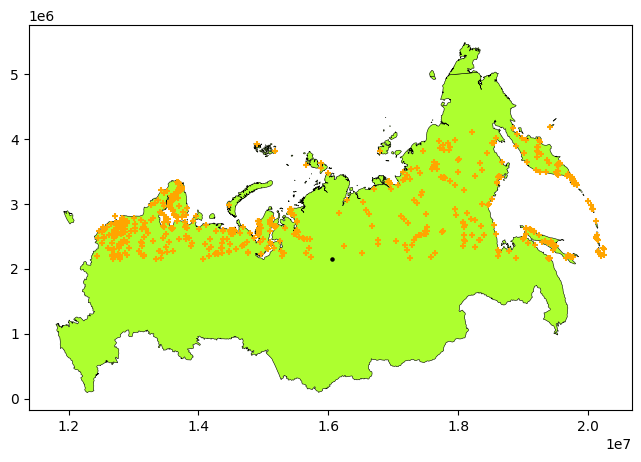

In [ ]:
# Base del mapa
base = rusia_6078.plot(facecolor="greenyellow", edgecolor='black', linewidth=0.4, figsize=(9,5))

# Centróide
rusia_6078.centroid.plot(color='black', markersize=5, ax=base)

#Aeropuertos de Rusia por encima del centroide (coordenadas y menores que 2148267.30328144)
airports_Rusia.cx[minx:20258831.95747615, maxy:2148267.30328144].plot(
    marker='+', color='orange', markersize=15, ax=base)

<Axes: >

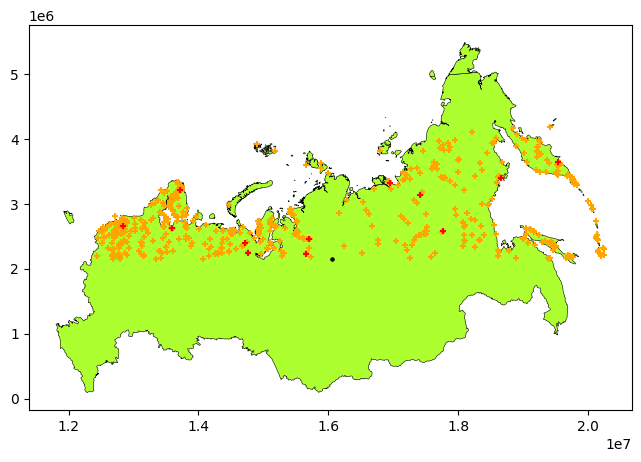

In [ ]:
#Ciudades y aeropuertos por encima del centroide
base = rusia_6078.plot(facecolor="greenyellow", edgecolor='black', linewidth=0.4, figsize=(9,5))
rusia_6078.centroid.plot(color='black', markersize=5, ax=base)
airports_Rusia.cx[minx:20258831.95747615, maxy:2148267.30328144].plot(
    marker='+', color='orange', markersize=15, ax=base)
citiesRusia_clipped.cx[minx:19725723.21361826 , maxy: 2148267.30328144].plot(
    marker='+', color='red', markersize=15, ax=base)

<Axes: >

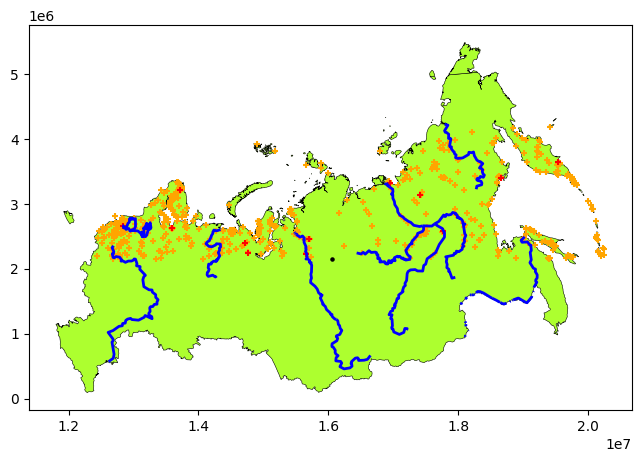

In [ ]:
#Ríos que cruzan esas divisiones
base = rusia_6078.plot(facecolor="greenyellow", edgecolor='black', linewidth=0.4, figsize=(9,5))
rusia_6078.centroid.plot(color='black', markersize=5, ax=base)
airports_Rusia.cx[minx:20258831.95747615, maxy:2148267.30328144].plot(
    marker='+', color='orange', markersize=15, ax=base)
citiesRusia_clipped.cx[minx:19725723.21361826 , maxy: 2148267.30328144].plot(
    marker='+', color='red', markersize=15, ax=base)
riversRusia_clipped.cx[minx:19217871.01839928 , maxy: 2348267.30328144].plot(edgecolor='blue', linewidth=2,
    ax=base)

In [ ]:
set(rusia_6078.geom_type), set(citiesRusia_clipped.geom_type), set(riversRusia_clipped.geom_type)

({'MultiPolygon'}, {'Point'}, {'LineString', 'MultiLineString'})

In [ ]:
#PROBLEMA 2:

Link_rusia="https://github.com/Halabbi/introgeodf2/raw/refs/heads/main/rusiaMAPAS_6078%20(1).gpkg"
import geopandas as gpd
from  fiona import listlayers

listlayers(Link_rusia)


['country',
 'cities',
 'rivers',
 'airports',
 'rusia_states',
 'rusia_municipalities']

<Axes: >

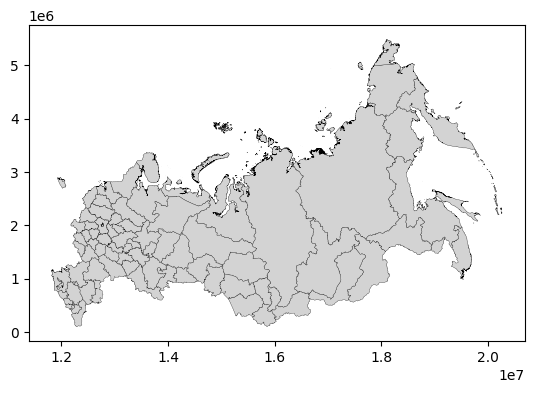

In [ ]:
rusia_municipalities=gpd.read_file(Link_rusia,layer='rusia_municipalities')
rusia_municipalities.plot(facecolor='lightgrey', edgecolor='black',linewidth=0.2)

In [ ]:
rusia_municipalities.head()

,ADM0_EN,ADM0_PCODE,ADM1_EN,ADM1_PCODE,ADM2_EN,ADM2_PCODE,UNHCR_code,geometry
0,Russian Federation,RU,Ural Federal District,RU007,Chelyabinsk,RU007001,20RUS007001,"MULTIPOLYGON Z (((14115166.204 1222034.471 0, ..."
1,Russian Federation,RU,North Caucasus federal district,RU003,Ingush,RU003003,20RUS003003,"MULTIPOLYGON Z (((12235424.873 502594.853 0, 1..."
2,Russian Federation,RU,South federal district,RU006,Adygey,RU006001,20RUS006001,"MULTIPOLYGON Z (((12003208.011 962837.238 0, 1..."
3,Russian Federation,RU,Volga Federal District,RU008,Bashkortostan,RU008001,20RUS008001,"MULTIPOLYGON Z (((13736990.21 1403699.147 0, 1..."
4,Russian Federation,RU,South federal district,RU006,Astrakhan',RU006002,20RUS006002,"MULTIPOLYGON Z (((12729057.298 922575.797 0, 1..."


In [ ]:
# numero de municipalidades
len(rusia_municipalities.ADM2_EN)

83

In [ ]:
# numero de distritos federales
len(set(rusia_municipalities.ADM1_EN))

8

<Axes: >

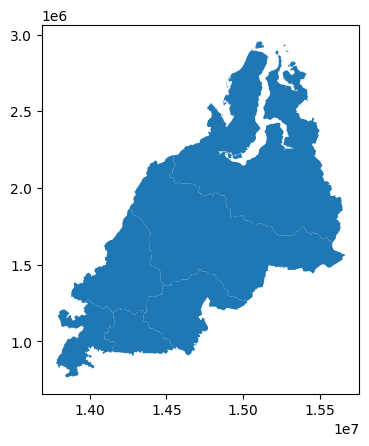

In [ ]:
#municipalidades del distrito federal Ural
rusia_municipalities[rusia_municipalities.ADM1_EN=='Ural Federal District'].plot()

In [ ]:
#creamos una geometría única para el distrito federal de los Urales al unir todos sus municipios
UralFederalDistrict_union=rusia_municipalities[rusia_municipalities.ADM1_EN=='Ural Federal District'].union_all()
UralFederalDistrict_union

In [ ]:
#corroboramos que la union se dio correctamente
type(UralFederalDistrict_union)

shapely.geometry.multipolygon.MultiPolygon

In [ ]:
#distrito federal Ural unificado
gpd.GeoDataFrame(index=[0],data={'ADM':'Ural Federal District'},
                 crs=rusia_municipalities.crs,
                 geometry=[UralFederalDistrict_union])


,ADM,geometry
0,Ural Federal District,"MULTIPOLYGON Z (((14535322.461 940591.219 0, 1..."


<Axes: >

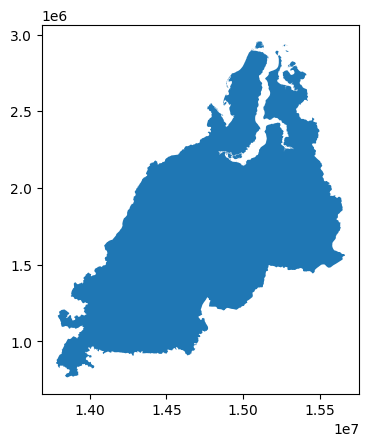

In [ ]:
#Podemos obtener lo mismo usando dissolve
rusia_municipalities[rusia_municipalities.ADM1_EN=='Ural Federal District'].dissolve().plot()

In [ ]:
UralFederalDistrict_dissolve=rusia_municipalities[rusia_municipalities.ADM1_EN=='Ural Federal District'].dissolve()

type(UralFederalDistrict_dissolve)

geopandas.geodataframe.GeoDataFrame

In [ ]:
# Verificar el resultado
UralFederalDistrict_dissolve

,geometry,ADM0_EN,ADM0_PCODE,ADM1_EN,ADM1_PCODE,ADM2_EN,ADM2_PCODE,UNHCR_code
0,"MULTIPOLYGON Z (((14535322.461 940591.219 0, 1...",Russian Federation,RU,Ural Federal District,RU007,Chelyabinsk,RU007001,20RUS007001


In [ ]:
#eliminamos las columnas que no son necesarias
UralFederalDistrict_dissolve.drop(columns=['ADM2_EN', 'ADM2_PCODE', 'UNHCR_code'], inplace=True)

# obtenemos
UralFederalDistrict_dissolve

,geometry,ADM0_EN,ADM0_PCODE,ADM1_EN,ADM1_PCODE
0,"MULTIPOLYGON Z (((14535322.461 940591.219 0, 1...",Russian Federation,RU,Ural Federal District,RU007


<Axes: >

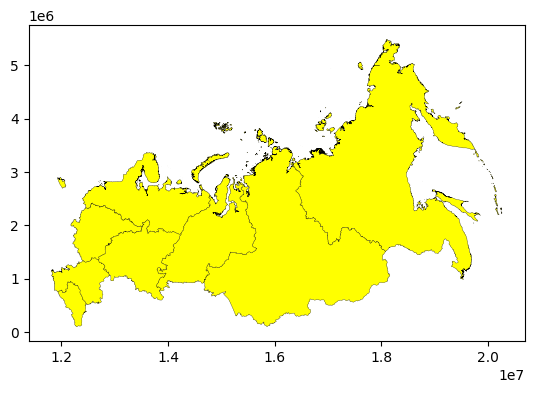

In [ ]:
#usando dissolve también para disolver las municipalidades de todos los distritos federales de rusia
rusia_municipalities.dissolve(by='ADM1_EN').plot(facecolor='yellow', edgecolor='black',linewidth=0.2)


In [ ]:
#obtenemos un solo polígono para cada región  de Rusia, en lugar de múltiples polígonos de cada municipio.
Rusia_adm1_diss=rusia_municipalities.dissolve(by='ADM1_EN')
Rusia_adm1_diss

In [ ]:
#eliminamos las columnas innesarias y obtenemos la info sobre Rusia_adm1_diss
Rusia_adm1_diss.drop(columns=['ADM2_EN','ADM2_PCODE','UNHCR_code'],inplace=True)
Rusia_adm1_diss.reset_index(inplace=True)
Rusia_adm1_diss.info()


<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 8 entries, 0 to 7
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   ADM1_EN     8 non-null      object  
 1   geometry    8 non-null      geometry
 2   ADM0_EN     8 non-null      object  
 3   ADM0_PCODE  8 non-null      object  
 4   ADM1_PCODE  8 non-null      object  
dtypes: geometry(1), object(4)
memory usage: 448.0+ bytes


EJERCICIO 3:

In [ ]:
#Agregamos a linkworldMAP la capa indicators
linkWorldMAP="https://github.com/CienciaDeDatosEspacial/intro_geodataframe/raw/main/maps/worldMaps.gpkg"
import geopandas as gpd
from  fiona import listlayers
listlayers(linkWorldMAP)

indicators=gpd.read_file(linkWorldMAP,layer='indicators')

In [ ]:
indicators.head()

,COUNTRY,Officialstatename,InternetccTLD,iso2,iso3,fragility_date,fragility,co2,co2_date,region,ForestRev_gdp,ForestRev_date,fragility_Qt,fragility_Qt_jc5,fragility_Qt_jc5_cat,geometry
0,ANTIGUA AND BARBUDA,Antigua and Barbuda,.ag,AG,ATG,2019,54.4,729000.0,2019,CENTRAL AMERICA AND THE CARIBBEAN,0.00,2018,-0.530113,1,1_Good,"MULTIPOLYGON (((-61.73889 17.54055, -61.75195 ..."
1,AFGHANISTAN,The Islamic Republic of Afghanistan,.af,AF,AFG,2019,105.0,7893000.0,2019,SOUTH ASIA,0.20,2018,1.827146,4,4_Poor,"POLYGON ((61.27656 35.60725, 61.29638 35.62853..."
2,ALGERIA,The People's Democratic Republic of Algeria,.dz,DZ,DZA,2019,75.4,151633000.0,2019,AFRICA,0.10,2018,0.304520,3,3_Bad,"POLYGON ((-5.15213 30.18047, -5.13917 30.19236..."
3,AZERBAIJAN,The Republic of Azerbaijan,.az,AZ,AZE,2019,73.2,35389000.0,2019,MIDDLE EAST,0.02,2018,0.233695,2,2_Middle,"MULTIPOLYGON (((46.54037 38.87559, 46.49554 38..."
4,ALBANIA,The Republic of Albania,.al,AL,ALB,2019,58.9,3794000.0,2019,EUROPE,0.18,2018,-0.424447,1,1_Good,"POLYGON ((20.79192 40.43154, 20.78722 40.39472..."


In [ ]:
#ahora disolvemos los datos por región con la aggfunc
#agrupa las filas de indicators por la columna region, combinando geometrías
#en aggfunc agrega valores: agrupa el promedio de country, fragility, co2 y forestrev_gdp

indicators.dissolve(
     by="region",
     aggfunc={
         "COUNTRY": "count",
         "fragility": ["mean"],
         "co2": ["mean"],
         "ForestRev_gdp": ["mean"]
     },as_index=False,
 )

,region,geometry,"(COUNTRY, count)","(fragility, mean)","(co2, mean)","(ForestRev_gdp, mean)"
0,AFRICA,"MULTIPOLYGON (((-2.92813 5.10022, -2.93222 5.1...",51,85.664706,1.670835e+07,3.239804
1,AUSTRALIA AND OCEANIA,"MULTIPOLYGON (((-176.51779 -43.90778, -176.532...",6,55.100000,7.679500e+07,3.630000
2,CENTRAL AMERICA AND THE CARIBBEAN,"MULTIPOLYGON (((-81.71556 7.44681, -81.71362 7...",16,62.993750,1.104856e+07,0.359375
3,CENTRAL ASIA,"MULTIPOLYGON (((50.03472 45.04833, 50.0425 45....",6,72.883333,3.898807e+08,0.236667
4,EAST AND SOUTHEAST ASIA,"MULTIPOLYGON (((105.26361 -6.54472, 105.26138 ...",15,64.120000,9.608337e+08,0.586667
5,EUROPE,"MULTIPOLYGON (((-18.13223 27.77264, -18.1132 2...",39,40.348718,9.866674e+07,0.199231
6,MIDDLE EAST,"MULTIPOLYGON (((42.76819 14.06653, 42.7868 14....",16,71.756250,1.583754e+08,0.032500
7,NORTH AMERICA,"MULTIPOLYGON (((-155.211 20.00166, -155.18335 ...",3,42.566667,2.073395e+09,0.073333
8,SOUTH AMERICA,"MULTIPOLYGON (((-74.93431 -51.85501, -74.93251...",11,61.436364,8.613718e+07,1.064545
9,SOUTH ASIA,"MULTIPOLYGON (((73.10193 -0.58431, 73.09915 -0...",8,83.975000,3.309434e+08,0.365000


<Axes: >

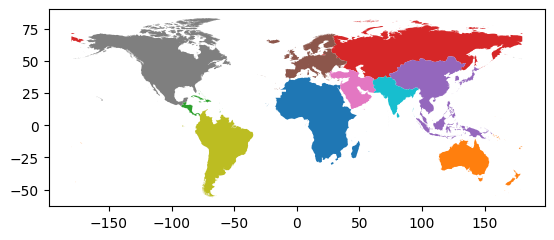

In [ ]:
#ahora almacenamos el resultado en indicadores_por_region
#visualizamos con plot
indicadores_por_region=indicators.dissolve(
     by="region",
     aggfunc={
         "COUNTRY": "count",
         "fragility": ["mean"],
         "co2": ["mean"],
         "ForestRev_gdp": ["mean"]
     },as_index=False,
 )


indicadores_por_region.plot(column = 'region')

In [ ]:
!pip install mapclassify

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.1/59.1 kB 2.1 MB/s eta 0:00:00


<Axes: >

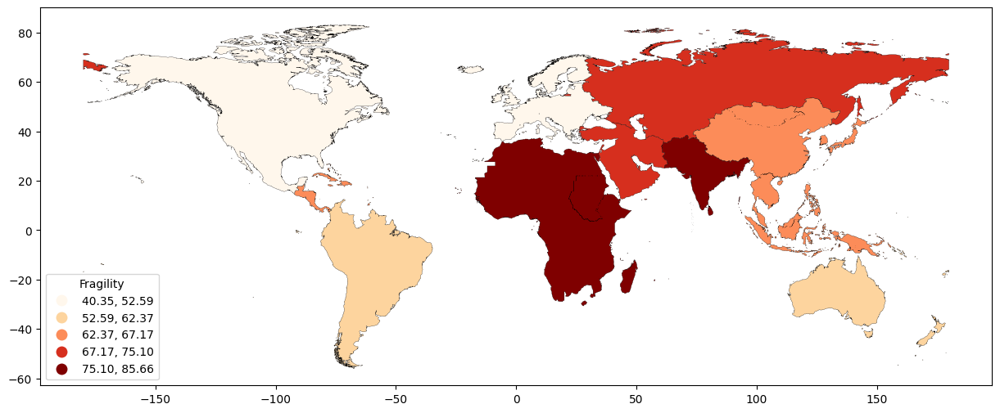

In [ ]:
#para visualizar mejor el indicador de fragilidad con una paleta de color
indicadores_por_region.plot(column =('fragility', 'mean'),scheme='quantiles', cmap='OrRd',
                        legend=True,
                        legend_kwds={"title": "Fragility",'loc': 'lower left'},
                        edgecolor='black',linewidth=0.2,
                        figsize=(15, 10))

In [ ]:
rusia_6078.centroid

,0
188,POINT (16052701.159 2148267.303)


In [ ]:
#calculamos las coordenadas del centroide de rusia
rusia_6078.centroid.x.values[0],rusia_6078.centroid.y.values[0]

(16052701.159460908, 2148267.3032814446)

In [ ]:
#reemplazamos type por kind porque en la data que tenemos
#hay una columna type, esto nos puede causar problemas en el siguiente código,por eso el cambio
airports_Rusia.rename(columns={'type': 'kind'}, inplace=True)
airports_Rusia.head()

,name,kind,latitude_deg,longitude_deg,elevation_ft,iso_region,municipality,geometry
0,Dalnegorsk Airport,small_airport,44.558748,135.490005,833.0,RU-PRI,Dalnegorsk,POINT (19607662.474 1506754.038)
1,Dalnerechensk Airport,small_airport,45.877949,133.735822,272.0,RU-PRI,Dalnerechensk,POINT (19381620.39 1491586.152)
2,Deputatskiy Airport,small_airport,69.392503,139.890012,950.0,RU-SA,Deputatskiy,POINT (17418835.504 3472608.835)
3,Levashovo Air Base,medium_airport,60.086700,30.193300,60.0,RU-SPE,St. Petersburg,POINT (12842271.541 2684604.065)
4,Afrikanda Air Base,closed,67.456703,32.786701,505.0,RU-MUR,Afrikanda,POINT (13576772.441 3119529.771)


In [ ]:
# Definimos las coordenadas del centroide
centroidX,centroidY=rusia_6078.centroid.x.values[0],rusia_6078.centroid.y.values[0]

# Segmentamos los aeropuertos de Rusia en cuadrantes
Rusia_AirTopLeft=airports_Rusia[airports_Rusia.kind=='medium_airport'].cx[:centroidX,centroidY:]
Rusia_AirTopRight=airports_Rusia[airports_Rusia.kind=='medium_airport'].cx[centroidX:,centroidY:]
Rusia_AirBottomLeft=airports_Rusia[airports_Rusia.kind=='medium_airport'].cx[:centroidX,:centroidY]
Rusia_AirBottomRight=airports_Rusia[airports_Rusia.kind=='medium_airport'].cx[centroidX:,:centroidY]

<Axes: >

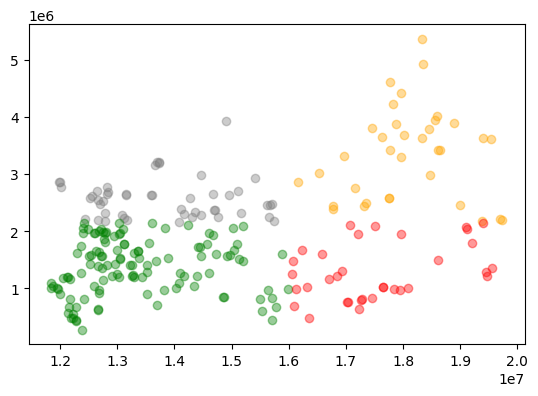

In [ ]:
#graficamos los aeropuertos por cuadrante
base=Rusia_AirTopLeft.plot(facecolor='grey', alpha=0.4)
Rusia_AirTopRight.plot(ax=base,facecolor='orange', alpha=0.4)
Rusia_AirBottomLeft.plot(ax=base,facecolor='green', alpha=0.4)
Rusia_AirBottomRight.plot(ax=base,facecolor='red', alpha=0.4)

In [ ]:
Rusia_AirBottomLeft

,name,kind,latitude_deg,longitude_deg,elevation_ft,iso_region,municipality,geometry
12,Balashov Air Base,medium_airport,51.533298,43.299999,568.0,RU-SAR,Balashov,POINT (12739700.429 1360162.599)
16,Borisoglebsk Air Base,medium_airport,51.366699,42.178299,390.0,RU-VOR,Borisoglebsk,POINT (12661688.435 1398398.108)
20,Buturlinovka Air Base,medium_airport,50.792210,40.606155,505.0,RU-VOR,Buturlinovka,POINT (12525743.518 1424049.446)
37,Grozny Airport,medium_airport,43.388106,45.699772,548.0,RU-CE,Grozny,POINT (12283048.407 442114.017)
45,Mius Airport,medium_airport,54.958332,43.311668,525.0,RU-NIZ,Sarov,POINT (12997487.012 1678016.971)
...,...,...,...,...,...,...,...,...
1656,Balakovo Airport,medium_airport,51.858299,47.745602,95.0,RU-SAR,Balakovo,POINT (13029644.38 1192456.728)
1668,Buguruslan Severny Airport,medium_airport,53.718399,52.371899,728.0,RU-ORE,Buguruslan,POINT (13432430.569 1201136.517)
1670,Bezymyanka Airfield,medium_airport,53.220001,50.325001,135.0,RU-SAM,Samara,POINT (13276886.07 1225331.901)
1679,Lebyazhye Air Base,medium_airport,50.201698,45.208302,381.0,RU-VGG,Kamyshin,POINT (12755670.107 1143286.445)


<Axes: >

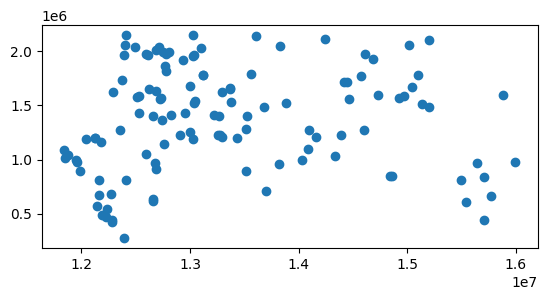

In [ ]:
#acá todavía no se puede hacer una envolvente convexa
Rusia_AirBottomLeft.convex_hull.plot()

<Axes: >

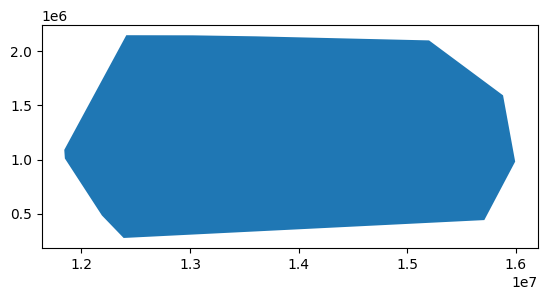

In [ ]:
#tenemos que Disolver y crear una envokvente de ángulos convexos
Rusia_AirBottomLeft.dissolve().convex_hull.plot()

In [ ]:
#acá observamos que es un polígono
Rusia_AirBottomLeft.dissolve().convex_hull

,0
0,"POLYGON ((12388442.758 277400.66, 12188335.559..."


<Axes: >

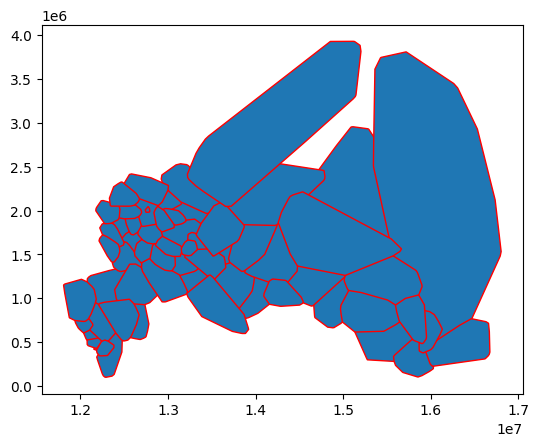

In [ ]:
#si nuestros polígonos no están previamente combinados, se usa la envolvente convexa
#al aplicar convex_hull se tiene una envolvente convexa individual para cada municipalidad

rusia_municipalities.cx[:centroidX,:centroidY].convex_hull.plot(edgecolor='red')

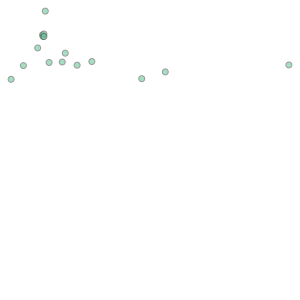

In [ ]:
#los large_airport se combinan en una sola geometría con union_all

large_airport=airports_Rusia[airports_Rusia.kind=='large_airport']
large_airport.union_all()

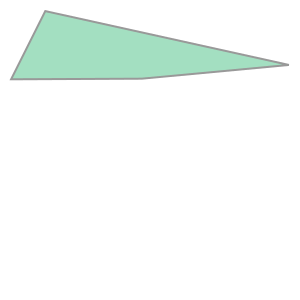

In [ ]:
#con convex_hull obtenemos una única envolvente convexa

large_airport.union_all().convex_hull

In [ ]:
#convertimos la geoserie a un geodataframe
LargeAirport_hull= gpd.GeoDataFrame(index=[0],
                                    crs=large_airport.crs,
                                    geometry=[large_airport.union_all().convex_hull])
LargeAirport_hull

,geometry
0,"POLYGON ((11878396.961 784544.53, 12818681.622..."


<Axes: >

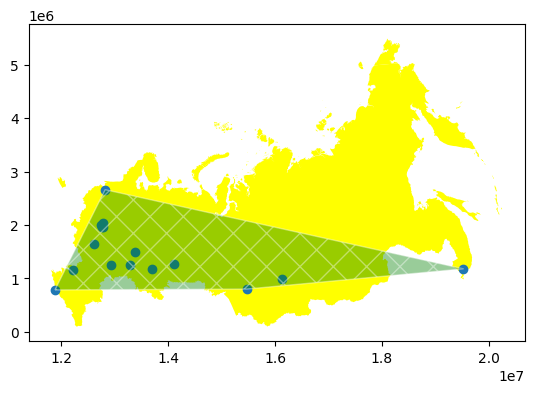

In [ ]:
#ploteamos
base=rusia_6078.plot(facecolor='yellow')
large_airport.plot(ax=base)
LargeAirport_hull.plot(ax=base,facecolor='green',
                       edgecolor='white',alpha=0.4,
                       hatch='X')

EJERCICIO 4:

In [ ]:
# Norte
MunisN_rusia=rusia_municipalities.cx[:,centroidY:]
# Sur
MunisS_rusia=rusia_municipalities.cx[:,:centroidY]
# Oeste
MunisW_rusia=rusia_municipalities.cx[:centroidX,:]
# Este
MunisE_rusia=rusia_municipalities.cx[centroidX:,:]

<Axes: >

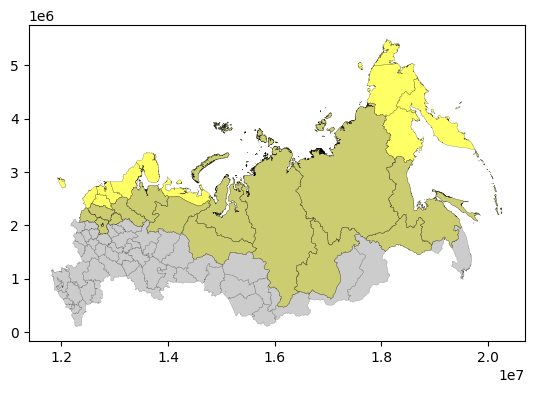

In [ ]:
base=MunisN_rusia.plot(facecolor='yellow', edgecolor='black',linewidth=0.2, alpha=0.6)
MunisS_rusia.plot(facecolor='grey', edgecolor='black',linewidth=0.2,ax=base, alpha=0.4)

<Axes: >

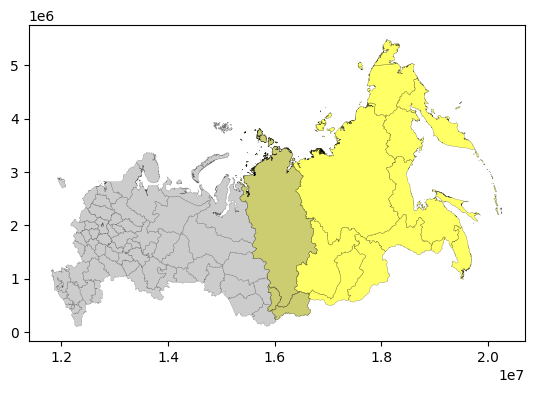

In [ ]:
#Gráfico de la superposición
base=MunisE_rusia.plot(facecolor='yellow', edgecolor='black',linewidth=0.2, alpha=0.6)
MunisW_rusia.plot(facecolor='grey', edgecolor='black',linewidth=0.2,ax=base, alpha=0.4)

<Axes: >

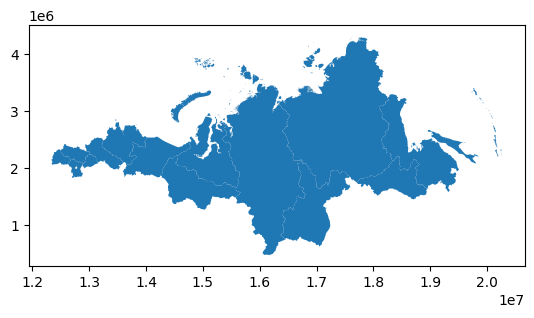

In [ ]:
# mantenemos lo que es común en GDF
munisNS_rusia=MunisN_rusia.overlay(MunisS_rusia, how="intersection",keep_geom_type=True)
munisNS_rusia.plot()

<Axes: >

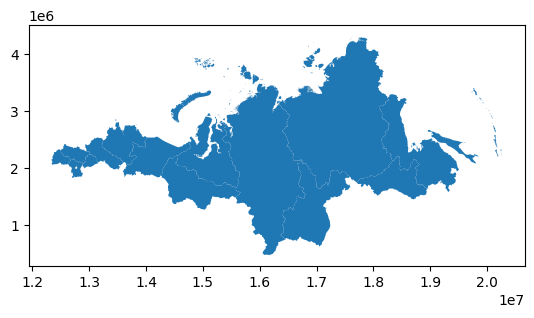

In [ ]:
MunisN_rusia.sjoin(MunisS_rusia, how="inner", predicate='contains').plot()

<Axes: >

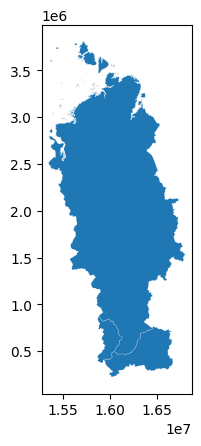

In [ ]:
# vamos a mantener la superposición
munisWE_rusia=MunisW_rusia.overlay(MunisE_rusia, how="intersection",keep_geom_type=True)
munisWE_rusia.plot(edgecolor='white',linewidth=0.1)

In [ ]:
#Unión de los dos GeoDF anteriores
munisNS_rusia.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 15 entries, 0 to 14
Data columns (total 15 columns):
 #   Column        Non-Null Count  Dtype   
---  ------        --------------  -----   
 0   ADM0_EN_1     15 non-null     object  
 1   ADM0_PCODE_1  15 non-null     object  
 2   ADM1_EN_1     15 non-null     object  
 3   ADM1_PCODE_1  15 non-null     object  
 4   ADM2_EN_1     15 non-null     object  
 5   ADM2_PCODE_1  15 non-null     object  
 6   UNHCR_code_1  15 non-null     object  
 7   ADM0_EN_2     15 non-null     object  
 8   ADM0_PCODE_2  15 non-null     object  
 9   ADM1_EN_2     15 non-null     object  
 10  ADM1_PCODE_2  15 non-null     object  
 11  ADM2_EN_2     15 non-null     object  
 12  ADM2_PCODE_2  15 non-null     object  
 13  UNHCR_code_2  15 non-null     object  
 14  geometry      15 non-null     geometry
dtypes: geometry(1), object(14)
memory usage: 1.9+ KB


In [ ]:
munisWE_rusia.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 3 entries, 0 to 2
Data columns (total 15 columns):
 #   Column        Non-Null Count  Dtype   
---  ------        --------------  -----   
 0   ADM0_EN_1     3 non-null      object  
 1   ADM0_PCODE_1  3 non-null      object  
 2   ADM1_EN_1     3 non-null      object  
 3   ADM1_PCODE_1  3 non-null      object  
 4   ADM2_EN_1     3 non-null      object  
 5   ADM2_PCODE_1  3 non-null      object  
 6   UNHCR_code_1  3 non-null      object  
 7   ADM0_EN_2     3 non-null      object  
 8   ADM0_PCODE_2  3 non-null      object  
 9   ADM1_EN_2     3 non-null      object  
 10  ADM1_PCODE_2  3 non-null      object  
 11  ADM2_EN_2     3 non-null      object  
 12  ADM2_PCODE_2  3 non-null      object  
 13  UNHCR_code_2  3 non-null      object  
 14  geometry      3 non-null      geometry
dtypes: geometry(1), object(14)
memory usage: 488.0+ bytes


In [ ]:
#Combinanción de las geometrías
keep=['ADM0_EN_1','ADM1_EN_1','ADM2_EN_1','geometry']
munisNS_rusia=munisNS_rusia.loc[:,keep]
munisWE_rusia=munisWE_rusia.loc[:,keep]

In [ ]:
# Las geometrías están correctas
munisNS_rusia.overlay(munisWE_rusia,how="union",keep_geom_type=True)

,ADM0_EN_1_1,ADM1_EN_1_1,ADM2_EN_1_1,ADM0_EN_1_2,ADM1_EN_1_2,ADM2_EN_1_2,geometry
0,Russian Federation,Siberian Federal District,Krasnoyarsk,Russian Federation,Siberian Federal District,Krasnoyarsk,"MULTIPOLYGON Z (((16286187.943 3215981.232 0, ..."
1,Russian Federation,Ural Federal District,Yamal-Nenets,NaN,NaN,NaN,"MULTIPOLYGON Z (((14815559.768 2524399.669 0, ..."
2,Russian Federation,Far Eastern Federal District,Sakha,NaN,NaN,NaN,"MULTIPOLYGON Z (((16456624.732 3095964.681 0, ..."
3,Russian Federation,Central Federal District,Yaroslavl',NaN,NaN,NaN,"POLYGON Z ((13098775.326 2206672.261 0, 131035..."
4,Russian Federation,Northwestern Federal District,Vologda,NaN,NaN,NaN,"POLYGON Z ((13234016.536 2505178.892 0, 132364..."
5,Russian Federation,Central Federal District,Moskva,NaN,NaN,NaN,"POLYGON Z ((12878179.222 2095526.89 0, 1287818..."
6,Russian Federation,Far Eastern Federal District,Khabarovsk,NaN,NaN,NaN,"MULTIPOLYGON Z (((18105966.229 3078452.168 0, ..."
7,Russian Federation,Northwestern Federal District,Komi,NaN,NaN,NaN,"POLYGON Z ((14770560.909 2453741.766 0, 147741..."
8,Russian Federation,Ural Federal District,Khanty-Mansiy,NaN,NaN,NaN,"POLYGON Z ((14539359.51 2111243.737 0, 1454010..."
9,Russian Federation,Siberian Federal District,Irkutsk,NaN,NaN,NaN,"POLYGON Z ((16735570.822 2135598.667 0, 167343..."


In [ ]:

import pandas as pd

pd.concat([munisNS_rusia,munisWE_rusia],ignore_index=True)

,ADM0_EN_1,ADM1_EN_1,ADM2_EN_1,geometry
0,Russian Federation,Ural Federal District,Yamal-Nenets,"MULTIPOLYGON Z (((14815640.739 2524375.07 0, 1..."
1,Russian Federation,Far Eastern Federal District,Sakha,"MULTIPOLYGON Z (((16456564.304 3095930.299 0, ..."
2,Russian Federation,Siberian Federal District,Krasnoyarsk,"MULTIPOLYGON Z (((16286244.056 3216009.491 0, ..."
3,Russian Federation,Central Federal District,Yaroslavl',"POLYGON Z ((13098775.326 2206672.261 0, 131035..."
4,Russian Federation,Northwestern Federal District,Vologda,"POLYGON Z ((13234016.536 2505178.892 0, 132364..."
5,Russian Federation,Central Federal District,Moskva,"POLYGON Z ((12878179.222 2095526.89 0, 1287818..."
6,Russian Federation,Far Eastern Federal District,Khabarovsk,"MULTIPOLYGON Z (((18105966.229 3078452.168 0, ..."
7,Russian Federation,Northwestern Federal District,Komi,"POLYGON Z ((14770560.909 2453741.766 0, 147741..."
8,Russian Federation,Ural Federal District,Khanty-Mansiy,"POLYGON Z ((14538141.004 2114423.131 0, 145393..."
9,Russian Federation,Siberian Federal District,Irkutsk,"POLYGON Z ((16729408.032 2141372.466 0, 167339..."


<Axes: >

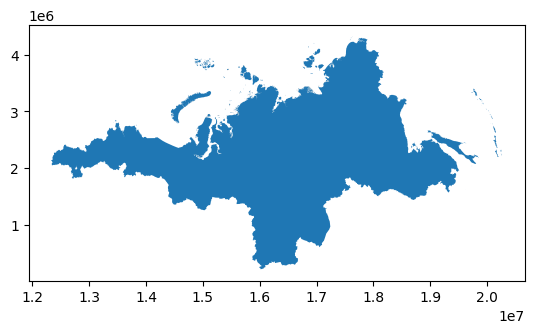

In [ ]:

munisNS_rusia.dissolve().overlay(munisWE_rusia.dissolve(), how="union",keep_geom_type=True).dissolve().plot()

In [ ]:
#Guarda el archivo
muniMidRusia=munisNS_rusia.dissolve().overlay(munisWE_rusia.dissolve(), how="union",keep_geom_type=True).dissolve()
muniMidRusia

In [ ]:
# Limpieza del código

muniMidRusia['zone']='middles'
muniMidRusia=muniMidRusia.loc[:,['ADM0_EN_1_1','zone','geometry']]
muniMidRusia

/usr/local/lib/python3.10/dist-packages/geopandas/geodataframe.py:2675: UserWarning: `keep_geom_type=True` in overlay resulted in 79 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  return geopandas.overlay(


<Axes: >

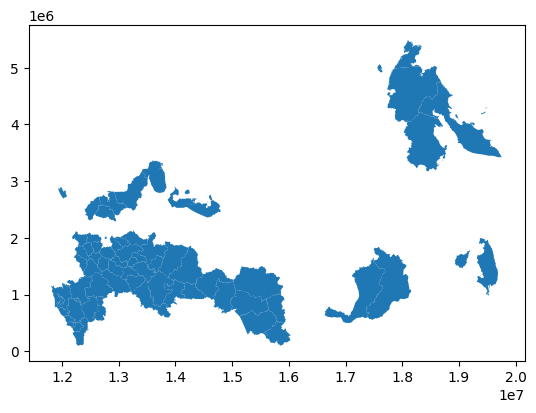

In [ ]:
#Diferencias con los municipios
rusia_municipalities.overlay(muniMidRusia, how='difference').plot()

<Axes: >

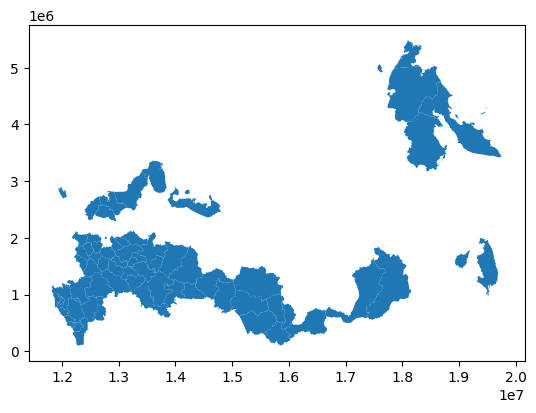

In [ ]:
#Diferencia simétrica
MunisN_rusia.overlay(MunisS_rusia, how="symmetric_difference",keep_geom_type=False).plot()

<Axes: >

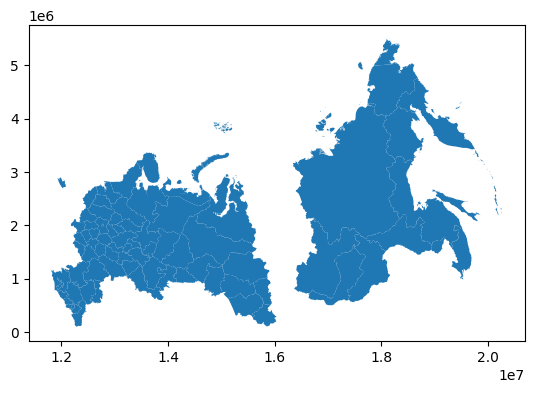

In [ ]:
#Se conserva lo que no está en la intersección
MunisW_rusia.overlay(MunisE_rusia, how="symmetric_difference",keep_geom_type=False).plot()